# Test tsne with different number of states and different sample size

# 发现不管怎样都会有一个比较空的区域，不知道为什么

In [1]:
from sklearn.manifold import TSNE as TSNE_sklearn

In [2]:
import torch 
import sklearn

import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.decomposition import PCA
from pandas import DataFrame
from collections import Counter

from tqdm import tqdm 
from data_utils import News20Data
from transformers import BertModel, BertTokenizer
from nltk.corpus import stopwords
from matplotlib.pyplot import figure
from matplotlib import collections as mc
from matplotlib.colors import ListedColormap

# Data io

In [3]:
STOPWORDS = stopwords.words('english')
STOPWORDS.extend(['"', "'", '.', ',', '?', '!', '-', '[CLS]', '[SEP]', '[PAD]',
  ':', '@', '/', '[', ']', '(', ')', 'would', 'like'])
STOPWORDS = set(STOPWORDS)

## Dataset

In [4]:
batch_size=20
dataset = News20Data(batch_size=batch_size)

Processing dataset ...
Reading data ...
... 0 seconds
Tokenizing and sorting train data ...
... 114 seconds
Tokenizing and sorting dev data ...
... 36 seconds
Tokenizing and sorting test data ...
... 39 seconds


## Model

In [5]:
bert = BertModel.from_pretrained('bert-base-uncased')
bert.to('cuda')
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [6]:
ckpt_path = '../models/bertnet_0.0.4.10.3/e9-model.pt'
ckpt = torch.load(ckpt_path)
state_matrix = ckpt['state_matrix']
state_matrix_py = state_matrix.cpu().numpy()

## State frequency

In [7]:
def read_state_freq(path):
    state_freq = np.zeros(2000)
    state_nonstop_freq = np.zeros(2000)
    with open(path) as fd:
        lines = fd.readlines()
        for li, l in enumerate(lines):
            if(li % 3 == 0):
                l = l.split()
                state_id = int(l[1])
                state_freq[state_id] = int(l[3])
                state_nonstop_freq[state_id] = int(l[5])
    return state_freq, state_nonstop_freq

In [8]:
state_freq, state_nonstop_freq = read_state_freq('/home/s1946695/Scale-CRF-Latent-Space/outputs/bertnet_0.0.4.10.3/bertnet_dev_epoch_9_s2w.txt')
state_freq_norm = np.log(state_freq)
state_freq_norm = state_freq_norm - state_freq_norm.min()
state_freq_norm = state_freq_norm / state_freq_norm.max()
state_nonstop_freq_r = state_nonstop_freq / state_freq
state_freq_idx_sort = state_freq.argsort()[::-1]
state_freq_idx_inverse = {}
for i, j in enumerate(state_freq_idx_sort):
    state_freq_idx_inverse[j] = i
state_stop_freq = state_freq - state_nonstop_freq

## Word Frequency

In [9]:
train_loader = dataset.train_dataloader()

In [10]:
all_tokens = []
for bi, batch in tqdm(enumerate(train_loader)):
    for bi_id in batch['input_ids']:
        t = tokenizer.convert_ids_to_tokens(bi_id)
        all_tokens.extend(t)
word_freq = Counter(all_tokens)

words_ = []
word_freq_norm = []
for wi, wf in word_freq.most_common():
    if(wi not in ['[CLS]', '[SEP]', '[PAD]']):
        words_.append(wi)
        word_freq_norm.append(np.log(wf))
word_freq_norm = np.array(word_freq_norm)
word_freq_norm -= word_freq_norm.min()
word_freq_norm += 0.1
word_freq_norm /= word_freq_norm.max()

word_freq_norm = {wi: wf for wi, wf in zip(words_, word_freq_norm)}

7836it [00:25, 304.25it/s]


## How many state that each word correspond to?

In [11]:
word_state_freq = {}
with open('/home/s1946695/Scale-CRF-Latent-Space/outputs/bertnet_0.0.4.10.3/bertnet_dev_epoch_9_s2w.txt') as fd:
    for l in fd:
        if l.startswith('state'):
            current_state = l.split()[1]
        else:
            words = l[:-4].split(' | ')
            for w in words:
                w = w.split(' ')[0]
                if(w in word_state_freq): 
                    if(current_state not in word_state_freq[w]): word_state_freq[w].append(current_state)
                else: word_state_freq[w] = [current_state]

words_ = []
freq_ = []
for w in word_state_freq: 
    words_.append(w)
    freq_.append(len(word_state_freq[w]))
freq_ = np.log(np.array(freq_))
freq_ = freq_ - freq_.min() + 0.1
freq_ /= freq_.max()

word_state_freq_norm = {w: f for w, f in zip(words_, freq_)}

## Embeddings

In [12]:
dev_loader = dataset.val_dataloader()

In [13]:
embeddings = []
tokens = []
# TODO: implement indexing
id2word = {}
wordid2sentid = {}
with torch.no_grad():
    for bi, batch in tqdm(enumerate(dev_loader)):
        if(bi == 1000): break
        emb = bert(batch['input_ids'].to('cuda'), batch['attention_mask'].to('cuda'))[0]
        for bij, bi_id in enumerate(batch['input_ids']):
            t = tokenizer.convert_ids_to_tokens(bi_id)
            tokens_len = len(tokens)
            for word_id, tij in enumerate(t):
                word_id = tokens_len + word_id
                id2word[word_id] = tij
                wordid2sentid[word_id] = bi * batch_size + bij
            tokens.extend(t)
        embeddings.append(emb.view(-1, 768))

1000it [00:25, 39.91it/s]


## Embedding Similarities

In [17]:
with torch.no_grad():
    embeddings = torch.cat(embeddings, 0).view(-1, 768)
    embeddings_total = torch.cat([state_matrix, embeddings], 0)

In [19]:
embeddings.size()

torch.Size([196520, 768])

In [69]:
with torch.no_grad():
    sim_word_state = torch.matmul(embeddings, state_matrix.transpose(0, 1))
    sim_state_state = torch.matmul(state_matrix, state_matrix.transpose(0, 1))
    state_links = sim_state_state.argmax(dim=-1).cpu().numpy()
#     sim_word_state = sim_word_state.cpu().numpy()
#     sim_state_state = sim_state_state.cpu().numpy()

In [98]:
sim_word_state.max(), sim_word_state.mean(), sim_word_state.min()

(tensor(12.1065, device='cuda:0'),
 tensor(1.1395, device='cuda:0'),
 tensor(-27.9584, device='cuda:0'))

In [99]:
sim_state_state.max(), sim_state_state.mean(), sim_state_state.min()

(tensor(62.1664, device='cuda:0'),
 tensor(1.9241, device='cuda:0'),
 tensor(-6.1972, device='cuda:0'))

# Preparations

## tSNE and plot

In [123]:
def tsne_preprocess(state_matrix, word_matrix, topk, sample_size):
    state_matrix = state_matrix.cpu().numpy()[freq_idx_sort][:topk]
    
    word_matrix = word_matrix.cpu().numpy()
    sample_idx = np.random.choice(len(word_matrix), sample_size, replace=False)
    word_matrix = word_matrix[sample_idx]
    
    n_state = state_matrix.shape[0]
    emb_matrix = np.concatenate([state_matrix, word_matrix], 0)
    
    n_state = np.zeros((emb_matrix.shape[0], 1)) + n_state
    inx = np.reshape(np.arange(emb_matrix.shape[0]), [emb_matrix.shape[0], 1])
    emb_matrix = np.concatenate([n_state, inx, emb_matrix], 1)
    return emb_matrix, sample_idx

def metric_fn_no_state(x1, x2):
    n_state = x1[0]
    x1_id = x1[1]
    x2_id = x2[1]
    if(x1_id < n_state and x2_id < n_state): 
        m = 100
    else:
        m = np.exp(-(x1[2:] * x2[2:]).sum())
    return m

def tsne_transform_dot_prod_no_state(emb_matrix, perplexity, n_iter, topk):
    """Do tsne"""
    tsne = TSNE_sklearn(n_components=2, verbose=2, perplexity=perplexity, n_iter=n_iter, metric=metric_fn_no_state, n_jobs=8)
    emb_transform = tsne.fit_transform(emb_matrix)
    
    emb_background = emb_transform[topk:]
    state_matrix_transform = emb_transform[: topk]
    return emb_background, state_matrix_transform

def get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids):
    word_sample_freq = []
    impute_cnt_ = 0
    for si in tqdm(sample_idx):
        si_word = id2word[emb_non_stop_ids[si]]
        if(si_word in word_freq_norm):
            word_sample_freq.append(word_freq_norm[si_word])
        else:
            word_sample_freq.append(0.5)
            impute_cnt_ += 1
    print(impute_cnt_)
    return np.array(word_sample_freq)

def plot_state_word(emb_background, 
                    state_matrix, 
                    state_nonstop_freq_r, 
                    state_freq_norm, 
                    word_freq_norm=None, 
                    word_only=False, 
                    state_size_base=1, 
                    filter_static=False, 
                    filter_contextualized=False
                   ):
    sns.set(rc={'figure.figsize':(8,6), 'figure.dpi': 200})
    plt.rcParams["font.size"] = 2
    
    fig, axs = plt.subplots(1, 1, constrained_layout=True) 

    s=1
    color = 'darkcyan'
    if(word_freq_norm is None):
        axs.scatter(x=emb_background[:, 0], y=emb_background[:, 1], s=s, color=color, linewidths=0, marker='D')
    else: 
        pcm = axs.scatter(x=emb_background[:, 0], y=emb_background[:, 1], s=s, c=1 - word_freq_norm,
                    cmap='coolwarm',linewidths=0, marker='D')
        cbar = fig.colorbar(pcm, ax=axs, location='top', ticks=[0.4, 0.6, 0.8])
        cbar.ax.set_xticklabels(['More frequent', 'Intermediate', 'Less frequent'], fontsize=10) 
        
    fig_all = plt.scatter(x=emb_background[0, 0], y=emb_background[0, 1], s=s, color=color, linewidths=0, marker='D')
    
    if(word_only == False):
        if(filter_static):
            idx_ = np.where(state_nonstop_freq_r < 0.5)
            state_matrix = state_matrix[idx_]
            state_nonstop_freq_r = state_nonstop_freq_r[idx_]
            state_freq_norm = state_freq_norm[idx_]
        if(filter_contextualized):
            idx_ = np.where(state_nonstop_freq_r > 0.5)
            state_matrix = state_matrix[idx_]
            state_nonstop_freq_r = state_nonstop_freq_r[idx_]
            state_freq_norm = state_freq_norm[idx_]
        state_color = [0, 99, 204]
        state_edgecolor = np.array((state_color[0]/255., state_color[1]/255., state_color[2]/255., 1.))
        fig_state = plt.scatter(x=state_matrix[:, 0], y=state_matrix[:, 1], c=state_nonstop_freq_r, 
                                cmap='Blues', edgecolors='tab:grey', s=state_size_base * np.exp(np.exp(state_freq_norm)) ** 2, 
                                linewidths=0.3, alpha=0.8
                               )

        x_ticks = plt.xticks(fontsize=8)
        y_ticks = plt.yticks(fontsize=8)

        cbar = plt.colorbar(ticks=[0.2, 0.5, 0.8])
        cbar.ax.set_yticklabels(['Static', 'Intermediate', 'Contextualized'], verticalalignment='center', rotation=270, fontsize=10) 

        plt.legend((fig_all, fig_state), ('Words', 'Latent states'), fontsize=10)
    return

def plot_state_word_w_query(emb_background, 
                            state_matrix, 
                            state_nonstop_freq_r, 
                            state_freq_norm, 
                            word_sample_freq=None, 
                            word_only=False, 
                            state_size_base=1, 
                            filter_static=False, 
                            filter_contextualized=False,
                            state_word_list=None,
                            high_light_query=False
                            ):
    sns.set(rc={'figure.figsize':(8,6), 'figure.dpi': 200})
    plt.rcParams["font.size"] = 2
    
    fig, axs = plt.subplots(1, 1, constrained_layout=True) 

    s=1
    color = 'darkcyan'
    ## plot words
    if(word_sample_freq is None):
        axs.scatter(x=emb_background[:, 0], y=emb_background[:, 1], s=s, color=color, linewidths=0, marker='D')
    else: 
        if(not high_light_query):
            pcm = axs.scatter(x=emb_background[:, 0], 
                        y=emb_background[:, 1], 
                        s=s,
                        c=1 - word_sample_freq,
                        cmap='coolwarm',
                        linewidths=0, 
                        marker='D')
            cbar = fig.colorbar(pcm, ax=axs, location='top', ticks=[0.4, 0.6, 0.8])
            cbar.ax.set_xticklabels(['More frequent', 'Intermediate', 'Less frequent'], fontsize=10) 
        else:
            axs.scatter(x=emb_background[:, 0], y=emb_background[:, 1], s=s, color=color, linewidths=0, marker='D', alpha=0.1)
            
        
    fig_all = plt.scatter(x=emb_background[0, 0], y=emb_background[0, 1], s=s, color=color, linewidths=0, marker='D')
    
    ## Plot states
    if(word_only == False):
        if(not high_light_query):
            state_color = [0, 99, 204]
            state_edgecolor = np.array((state_color[0]/255., state_color[1]/255., state_color[2]/255., 1.))
            if(filter_static):
                idx_ = np.where(state_nonstop_freq_r < 0.5)
                state_matrix_ = state_matrix[idx_]
                state_nonstop_freq_r_ = state_nonstop_freq_r[idx_]
                state_freq_norm_ = state_freq_norm[idx_]
                fig_state = plt.scatter(x=state_matrix_[:, 0], y=state_matrix_[:, 1], c=state_nonstop_freq_r_, cmap='Blues', edgecolors='tab:grey', 
                                        s=state_size_base * np.exp(np.exp(state_freq_norm_)) ** 2, linewidths=0.3, alpha=0.8)
            elif(filter_contextualized):
                idx_ = np.where(state_nonstop_freq_r > 0.5)
                state_matrix = state_matrix[idx_]
                state_nonstop_freq_r = state_nonstop_freq_r[idx_]
                state_freq_norm = state_freq_norm[idx_]
                fig_state = plt.scatter(x=state_matrix_[:, 0], y=state_matrix_[:, 1], c=state_nonstop_freq_r_, cmap='Blues', edgecolors='tab:grey', 
                                        s=state_size_base * np.exp(np.exp(state_freq_norm_)) ** 2, linewidths=0.3, alpha=0.8)
            else:
                fig_state = plt.scatter(x=state_matrix[:, 0], y=state_matrix[:, 1], c=state_nonstop_freq_r, cmap='Blues', edgecolors='tab:grey', 
                                        s=state_size_base * np.exp(np.exp(state_freq_norm)) ** 2, linewidths=0.3, alpha=0.8)

            x_ticks = plt.xticks(fontsize=8)
            y_ticks = plt.yticks(fontsize=8)

            cbar = plt.colorbar(ticks=[0.2, 0.5, 0.8])
            cbar.ax.set_yticklabels(['Static', 'Intermediate', 'Contextualized'], verticalalignment='center', rotation=270, fontsize=10) 
        else:
            fig_state = plt.scatter(x=state_matrix[:, 0], 
                        y=state_matrix[:, 1], 
                        color='tab:blue',
                        edgecolors='tab:grey', 
                        s=state_size_base * np.exp(np.exp(state_freq_norm)) ** 2, 
                        linewidths=0.3, 
                        alpha=0.1
                       )
        
    ## Plot queried states
    if(state_word_list is not None):
        state_idx = [li[0] for li in state_word_list]
        state_queried = state_matrix[state_idx]
        state_queried_freq_norm = state_freq_norm[state_idx]
        state_queried_nonstop_freq_r = state_nonstop_freq_r[state_idx]
        
        # queried states
        fig_state_query = plt.scatter(x=state_queried[:, 0], y=state_queried[:, 1], c=state_queried_nonstop_freq_r, cmap='Blues', edgecolors='tab:red', 
                                      s=state_size_base * np.exp(np.exp(state_queried_freq_norm)) ** 2, linewidths=1, alpha=0.8,zorder=2.5)
        
        word_idx = []
        for li in state_word_list: word_idx.extend(li[1])
        emb_query_background = emb_background[word_idx]
        word_query_sample_freq = word_sample_freq[word_idx]
            
        # corresponding words
        figure_words_query = plt.scatter(x=emb_query_background[:, 0], y=emb_query_background[:, 1], s=5,c=1 - word_query_sample_freq,
                          cmap='coolwarm', linewidths=0, marker='D', zorder=3)
        
        # lines
        lines = []
        line_color = [255, 214, 52]
        for sw in state_word_list:
            si = sw[0]
            wlist = sw[1]
            for wi in wlist:
                x1 = state_matrix[si, 0]
                x2 = emb_background[wi, 0]
                y1 = state_matrix[si, 1]
                y2 = emb_background[wi, 1]
                lines.append([(x1, y1), (x2, y2)])
        lines = mc.LineCollection(lines, linewidths=0.5, color=[255. / 255, 214. / 255, 52. / 255], alpha=0.8, linestyle='-.')
        axs.add_collection(lines)
            
        plt.legend((fig_all, fig_state, fig_state_query, figure_words_query), ('Words', 'Latent states', 'queried states', 'queried words'), fontsize=10)
    else:
        plt.legend((fig_all, fig_state), ('Words', 'Latent states'), fontsize=10)
    return

In [21]:
emb_non_stop = []
emb_non_stop_ids = []
emb_stop = []
emb_stop_ids = []
for wi, w in tqdm(enumerate(embeddings)):
    if(id2word[wi] in STOPWORDS):
        emb_stop.append(w)
        emb_stop_ids.append(wi)
    else:
        emb_non_stop.append(w)
        emb_non_stop_ids.append(wi)
emb_non_stop = torch.stack(emb_non_stop, 0)
emb_stop = torch.stack(emb_stop, 0)

196520it [00:00, 688745.65it/s]


In [22]:
print(emb_non_stop.size(), emb_stop.size())

torch.Size([73474, 768]) torch.Size([123046, 768])


## Query state-related words

In [113]:
def query_sim_words(state_id, sim_word_state, id2word, wordid2sentid, thres=3, k=2000):
    """Query similar words of a given state"""
    K = 50000
    torch.cuda.empty_cache()
    
    sim_words = []
    sim_words_in_sents = []
    _, sim_word_idx = sim_word_state[:, state_id].topk(K)
    for wi in sim_word_idx:
        wi = wi.item()
        w = id2word[wi]
        if(w in STOPWORDS): continue
        sim_words.append(w)
        sim_words_in_sents.append(wordid2sentid[wi])
        if(len(sim_words) == k): break
    sim_words_set = Counter(sim_words)
    sim_words_set_ = dict()
    for w, c in sim_words_set.most_common():
        if(c > thres):
            sim_words_set_[w] = c
    return sim_word_idx.cpu().numpy(), sim_words, sim_words_set_, sim_words_in_sents

def build_state_word_list(query_states, state_id_origin_to_topk, sim_word_state, id2word, wordid2sentid, word_id_origin_to_non_stop, word_id_non_stop_to_sampled, n_words=20):        
    state_word_list = []
    for si in query_states:
        sim_word_idx, sim_words, sim_words_set, sim_words_in_sents = query_sim_words(si, sim_word_state, id2word, wordid2sentid, thres=3, k=2000)
        sim_word_idx_ = []
        for wi in sim_word_idx:
            if(id2word[wi] in STOPWORDS): continue
            else: sim_word_idx_.append(wi)
        word_str = [id2word[wi] for wi in sim_word_idx_[:n_words]]
        sim_word_idx_ = [word_id_origin_to_non_stop[idx] for idx in sim_word_idx_]
        sim_word_idx_ = [word_id_non_stop_to_sampled[idx] for idx in sim_word_idx_ if idx in word_id_non_stop_to_sampled][:n_words]
        
        si = state_id_origin_to_topk[si]
        state_word_list.append([si, sim_word_idx_, word_str])
    return state_word_list

def build_state_word_list_transformed(s_idx, state_emb, word_emb, state_id_origin_to_topk, word_id_sampled_to_non_stop, word_id_non_stop_to_origin, id2word, n_words=20):
    state_word_list = []
    for si in s_idx:
        si = state_id_origin_to_topk[si]
        sim_words_idx = np.sum((word_emb - state_emb[si]) ** 2, -1).argsort()
        word_idx = []
        word_str = []
        for wi in sim_words_idx[:n_words]:
            word_idx.append(wi)
            wi_ = word_id_sampled_to_non_stop[wi]
            wi_ = word_id_non_stop_to_origin[wi_]
            word = id2word[wi_]
            word_str.append(word)
        state_word_list.append([si, word_idx, word_str])
    return state_word_list

def query_sim_word(word_idx, word_emb_sampled, word_id_sampled_to_non_stop, word_id_non_stop_to_origin):
    """Query in the original space
    word_idx: sampled_idx
    """
    sim_words_idx = np.sum(word_emb_sampled[:, 2:] * word_emb_sampled[word_idx][2:], 1).argsort()[::-1]
    sim_words_idx = [word_id_non_stop_to_origin[word_id_sampled_to_non_stop[wi]] for wi in sim_words_idx]
    return sim_words_idx

def query_sim_word_transformed(word_idx, word_emb_transformed, word_id_non_stop_to_origin, word_id_sampled_to_non_stop):
    """Query in the transformed space
    """
    sim_words_idx = np.sum((word_emb_transformed - word_emb_transformed[word_idx])**2, 1).argsort()
    sim_words_idx = [word_id_non_stop_to_origin[word_id_sampled_to_non_stop[si]] for si in sim_words_idx]
    return sim_words_idx

# Tests ppl topk sample size

## PPL = 10, top k = 500, sample size = 2000

In [29]:
topk=500
sample_size = 2000
embeddings_vis, sample_idx = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, 10, 1000, topk)

/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 2500 samples in 0.002s...
[t-SNE] Computed neighbors for 2500 samples in 42.974s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2500
[t-SNE] Computed conditional probabilities for sample 2000 / 2500
[t-SNE] Computed conditional probabilities for sample 2500 / 2500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 1.296s
[t-SNE] Iteration 50: error = 81.5845108, gradient norm = 0.1130895 (50 iterations in 3.132s)
[t-SNE] Iteration 100: error = 82.3446579, gradient norm = 0.1233515 (50 iterations in 4.148s)
[t-SNE] Iteration 150: error = 82.8858643, gradient norm = 0.0931216 (50 iterations in 3.371s)
[t-SNE] Iteration 200: error = 82.6628265, gradient norm = 0.1155086 (50 iterations in 3.391s)
[t-SNE] Iteration 250: error = 83.2126389, gradient norm = 0.1100695 (50 iterations in 3.162s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.212639
[t-SNE] Iteration 300: err

100%|██████████| 2000/2000 [00:00<00:00, 163170.74it/s]


2


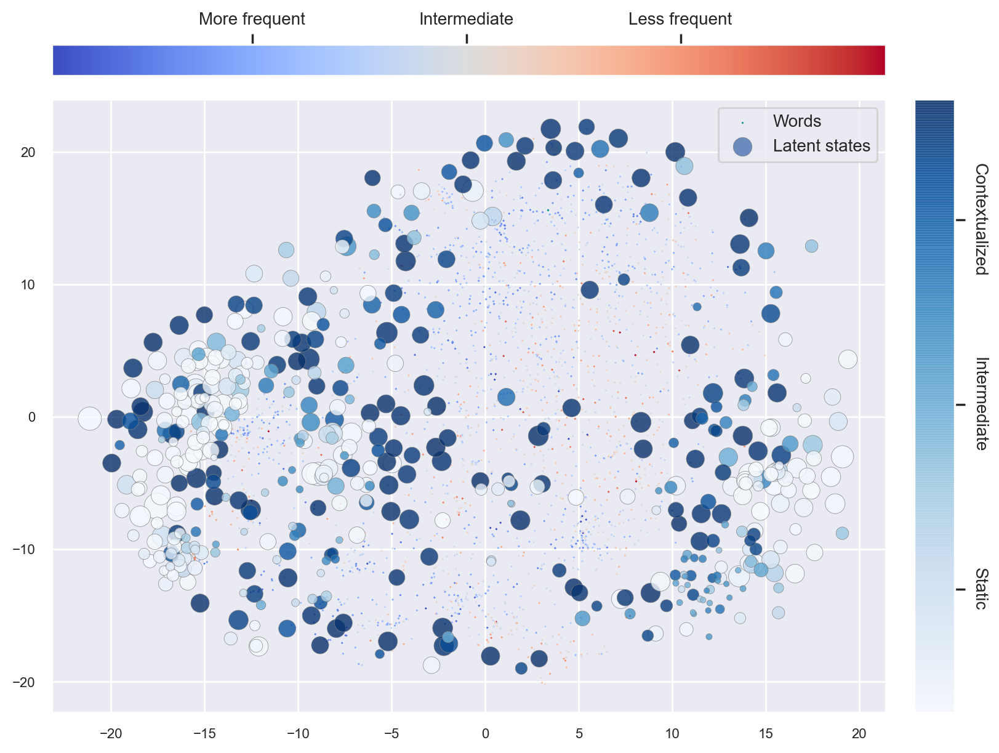

In [31]:
state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)

plot_state_word(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_, word_freq_norm=word_freq_norm_)

# 然后大部分 static 的 state 周围都没有词，这是可以期待的，猜测是因为它们对应的词并没有被 sample 到

## PPL = 5, top k = 500, sample size = 10000

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 10500 samples in 0.007s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 10500 samples in 789.473s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10500
[t-SNE] Computed conditional probabilities for sample 2000 / 10500
[t-SNE] Computed conditional probabilities for sample 3000 / 10500
[t-SNE] Computed conditional probabilities for sample 4000 / 10500
[t-SNE] Computed conditional probabilities for sample 5000 / 10500
[t-SNE] Computed conditional probabilities for sample 6000 / 10500
[t-SNE] Computed conditional probabilities for sample 7000 / 10500
[t-SNE] Computed conditional probabilities for sample 8000 / 10500
[t-SNE] Computed conditional probabilities for sample 9000 / 10500
[t-SNE] Computed conditional probabilities for sample 10000 / 10500
[t-SNE] Computed conditional probabilities for sample 10500 / 10500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.397s
[t-SNE] Iteration 50: error = 103.4342575, gradient norm = 0.0011299 (50 iterations in 10.345s)
[t-SNE] Iteration 100: 

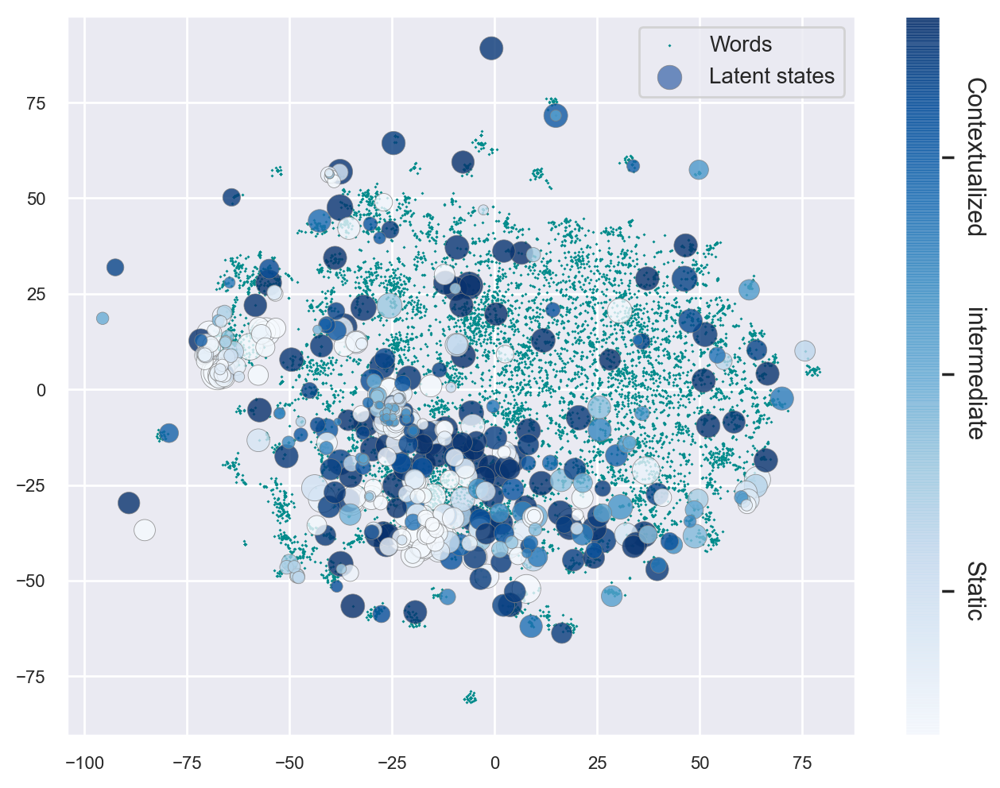

In [52]:
topk=500
sample_size = 10000

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=5, n_iter=1000, topk=topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 10500 samples in 0.007s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 10500 samples in 781.240s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10500
[t-SNE] Computed conditional probabilities for sample 2000 / 10500
[t-SNE] Computed conditional probabilities for sample 3000 / 10500
[t-SNE] Computed conditional probabilities for sample 4000 / 10500
[t-SNE] Computed conditional probabilities for sample 5000 / 10500
[t-SNE] Computed conditional probabilities for sample 6000 / 10500
[t-SNE] Computed conditional probabilities for sample 7000 / 10500
[t-SNE] Computed conditional probabilities for sample 8000 / 10500
[t-SNE] Computed conditional probabilities for sample 9000 / 10500
[t-SNE] Computed conditional probabilities for sample 10000 / 10500
[t-SNE] Computed conditional probabilities for sample 10500 / 10500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.400s
[t-SNE] Iteration 50: error = 103.4295273, gradient norm = 0.0014274 (50 iterations in 12.612s)
[t-SNE] Iteration 100: 

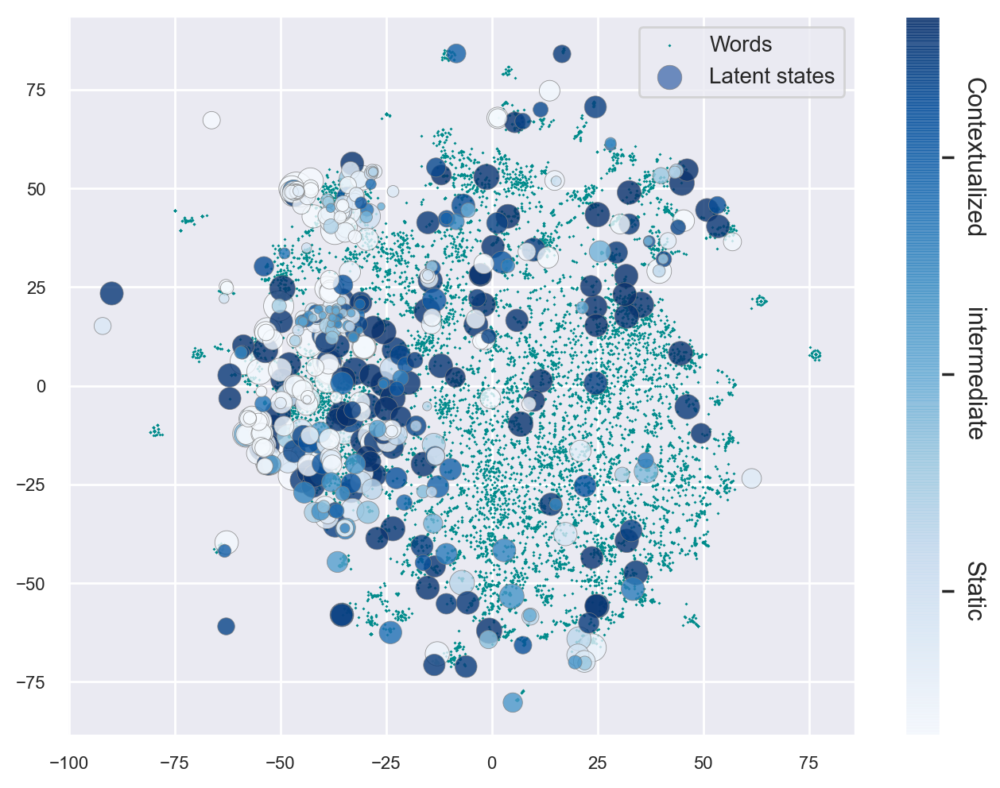

In [53]:
topk=500
sample_size = 10000

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=5, n_iter=1000, topk=topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

## PPL = 10, top k = 500, sample size = 10000

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 10500 samples in 0.007s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 10500 samples in 785.337s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10500
[t-SNE] Computed conditional probabilities for sample 2000 / 10500
[t-SNE] Computed conditional probabilities for sample 3000 / 10500
[t-SNE] Computed conditional probabilities for sample 4000 / 10500
[t-SNE] Computed conditional probabilities for sample 5000 / 10500
[t-SNE] Computed conditional probabilities for sample 6000 / 10500
[t-SNE] Computed conditional probabilities for sample 7000 / 10500
[t-SNE] Computed conditional probabilities for sample 8000 / 10500
[t-SNE] Computed conditional probabilities for sample 9000 / 10500
[t-SNE] Computed conditional probabilities for sample 10000 / 10500
[t-SNE] Computed conditional probabilities for sample 10500 / 10500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.918s
[t-SNE] Iteration 50: error = 94.9503555, gradient norm = 0.0007339 (50 iterations in 10.714s)
[t-SNE] Iteration 100: e

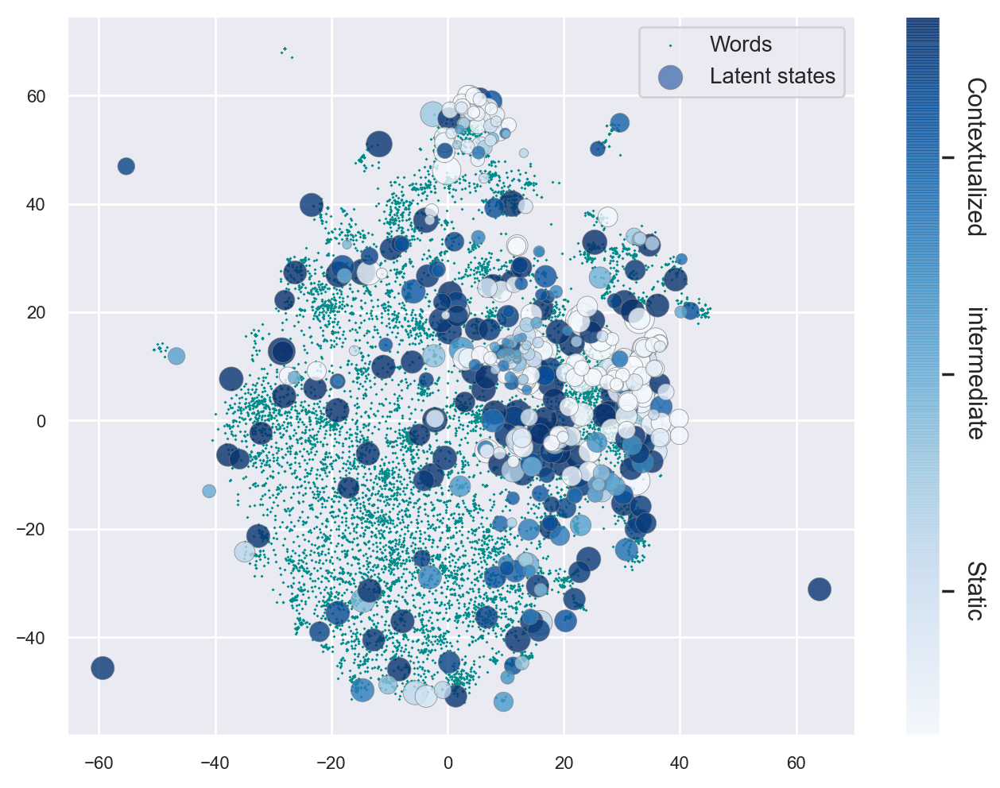

In [44]:
topk=500
sample_size = 10000

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=10, n_iter=1000, topk=topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 10500 samples in 0.007s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 10500 samples in 791.961s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10500
[t-SNE] Computed conditional probabilities for sample 2000 / 10500
[t-SNE] Computed conditional probabilities for sample 3000 / 10500
[t-SNE] Computed conditional probabilities for sample 4000 / 10500
[t-SNE] Computed conditional probabilities for sample 5000 / 10500
[t-SNE] Computed conditional probabilities for sample 6000 / 10500
[t-SNE] Computed conditional probabilities for sample 7000 / 10500
[t-SNE] Computed conditional probabilities for sample 8000 / 10500
[t-SNE] Computed conditional probabilities for sample 9000 / 10500
[t-SNE] Computed conditional probabilities for sample 10000 / 10500
[t-SNE] Computed conditional probabilities for sample 10500 / 10500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 0.788s
[t-SNE] Iteration 50: error = 94.9584427, gradient norm = 0.0008553 (50 iterations in 17.577s)
[t-SNE] Iteration 100: e

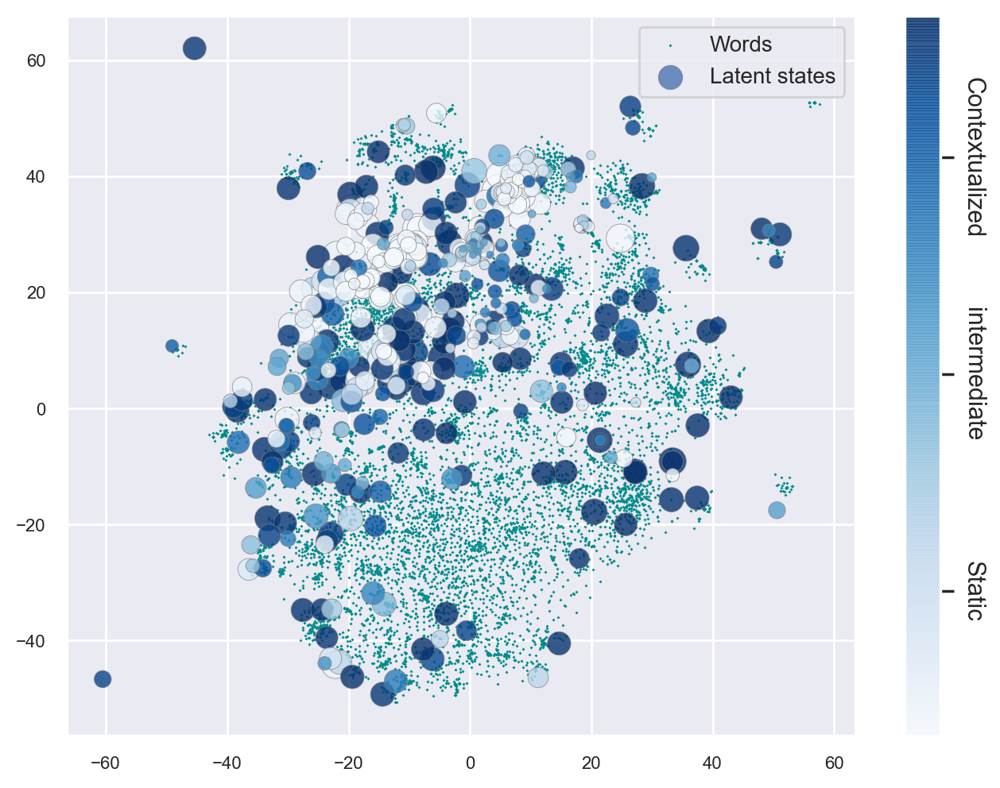

In [49]:
topk=500
sample_size = 10000

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=10, n_iter=1000, topk=topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

## PPL = 50, top k = 500, sample size = 10000. 这个发现不大行，states 没有很散开

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 10500 samples in 0.007s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 10500 samples in 781.867s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10500
[t-SNE] Computed conditional probabilities for sample 2000 / 10500
[t-SNE] Computed conditional probabilities for sample 3000 / 10500
[t-SNE] Computed conditional probabilities for sample 4000 / 10500
[t-SNE] Computed conditional probabilities for sample 5000 / 10500
[t-SNE] Computed conditional probabilities for sample 6000 / 10500
[t-SNE] Computed conditional probabilities for sample 7000 / 10500
[t-SNE] Computed conditional probabilities for sample 8000 / 10500
[t-SNE] Computed conditional probabilities for sample 9000 / 10500
[t-SNE] Computed conditional probabilities for sample 10000 / 10500
[t-SNE] Computed conditional probabilities for sample 10500 / 10500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 3.864s
[t-SNE] Iteration 50: error = 76.6460571, gradient norm = 0.0000000 (50 iterations in 10.191s)
[t-SNE] Iteration 50: gr

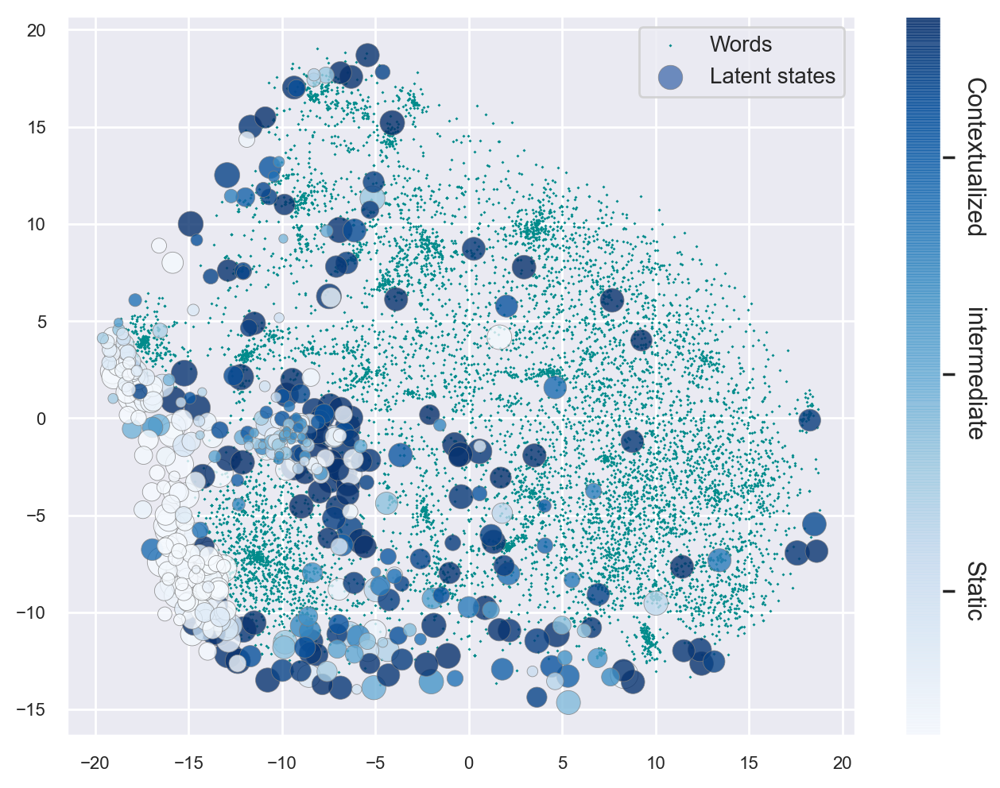

In [50]:
topk=500
sample_size = 10000

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=50, n_iter=1000, topk=topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 10500 samples in 0.007s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 10500 samples in 791.530s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10500
[t-SNE] Computed conditional probabilities for sample 2000 / 10500
[t-SNE] Computed conditional probabilities for sample 3000 / 10500
[t-SNE] Computed conditional probabilities for sample 4000 / 10500
[t-SNE] Computed conditional probabilities for sample 5000 / 10500
[t-SNE] Computed conditional probabilities for sample 6000 / 10500
[t-SNE] Computed conditional probabilities for sample 7000 / 10500
[t-SNE] Computed conditional probabilities for sample 8000 / 10500
[t-SNE] Computed conditional probabilities for sample 9000 / 10500
[t-SNE] Computed conditional probabilities for sample 10000 / 10500
[t-SNE] Computed conditional probabilities for sample 10500 / 10500
[t-SNE] Mean sigma: 0.000000
[t-SNE] Computed conditional probabilities in 3.905s
[t-SNE] Iteration 50: error = 76.6898193, gradient norm = 0.0000000 (50 iterations in 10.331s)
[t-SNE] Iteration 50: gr

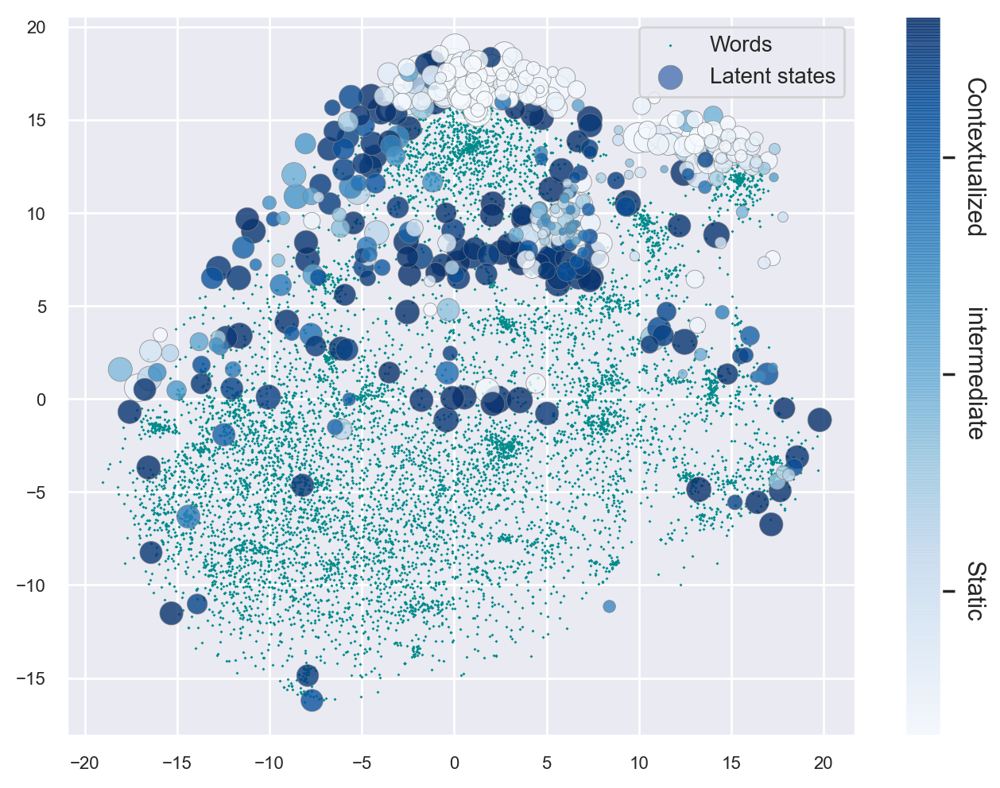

In [51]:
topk=500
sample_size = 10000

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=50, n_iter=1000, topk=topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

## PPL = 5, top k = 500, sample size = 22877

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 22877 samples in 0.016s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 22877 samples in 7645.025s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22877
[t-SNE] Computed conditional probabilities for sample 2000 / 22877
[t-SNE] Computed conditional probabilities for sample 3000 / 22877
[t-SNE] Computed conditional probabilities for sample 4000 / 22877
[t-SNE] Computed conditional probabilities for sample 5000 / 22877
[t-SNE] Computed conditional probabilities for sample 6000 / 22877
[t-SNE] Computed conditional probabilities for sample 7000 / 22877
[t-SNE] Computed conditional probabilities for sample 8000 / 22877
[t-SNE] Computed conditional probabilities for sample 9000 / 22877
[t-SNE] Computed conditional probabilities for sample 10000 / 22877
[t-SNE] Computed conditional probabilities for sample 11000 / 22877
[t-SNE] Computed conditional probabilities for sample 12000 / 22877
[t-SNE] Computed conditional probabilities for sample 13000 / 22877
[t-SNE] Computed conditional probabilities for sample 14000 / 22

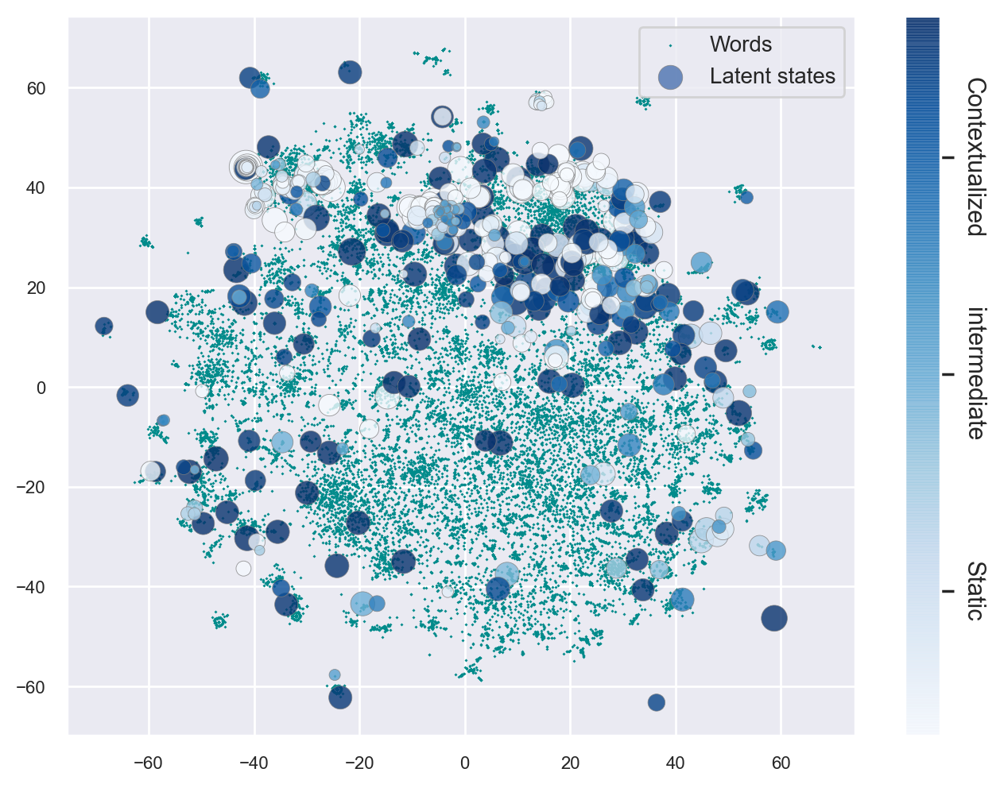

In [46]:
topk=500
sample_size = emb_non_stop.size()[0]

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, 5, 1000, topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

### Repeat

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 22877 samples in 0.014s...


/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computed neighbors for 22877 samples in 7408.190s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22877
[t-SNE] Computed conditional probabilities for sample 2000 / 22877
[t-SNE] Computed conditional probabilities for sample 3000 / 22877
[t-SNE] Computed conditional probabilities for sample 4000 / 22877
[t-SNE] Computed conditional probabilities for sample 5000 / 22877
[t-SNE] Computed conditional probabilities for sample 6000 / 22877
[t-SNE] Computed conditional probabilities for sample 7000 / 22877
[t-SNE] Computed conditional probabilities for sample 8000 / 22877
[t-SNE] Computed conditional probabilities for sample 9000 / 22877
[t-SNE] Computed conditional probabilities for sample 10000 / 22877
[t-SNE] Computed conditional probabilities for sample 11000 / 22877
[t-SNE] Computed conditional probabilities for sample 12000 / 22877
[t-SNE] Computed conditional probabilities for sample 13000 / 22877
[t-SNE] Computed conditional probabilities for sample 14000 / 22

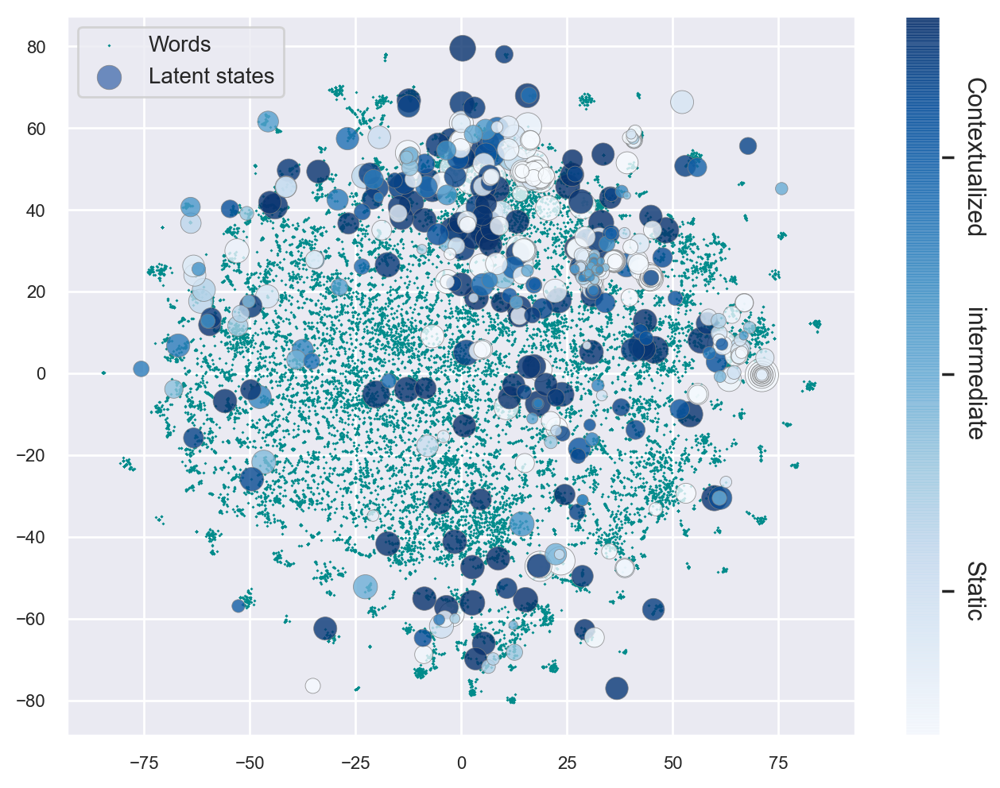

In [54]:
topk=500
sample_size = emb_non_stop.size()[0]

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_5, state_matrix_transform_perp_5 = tsne_transform_dot_prod_no_state(embeddings_vis, 5, 1000, topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

plot_state_non_stop(emb_background_perp_5, state_matrix_transform_perp_5, state_nonstop_freq_r_, state_freq_norm_)

# PPL = 10, top k = 500, sample size = 40000 <- 感觉应该用这个图 

In [35]:
topk=500
sample_size = 40000

embeddings_vis, sample_idx = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
embeddings_sampled = embeddings_vis[topk:]
emb_background_perp_10, state_matrix_transform_perp_10 = tsne_transform_dot_prod_no_state(embeddings_vis, perplexity=10, n_iter=5000, topk=topk)

/home/s1946695/miniconda3/envs/_dl_py36_dev/lib/python3.6/site-packages/sklearn/manifold/_t_sne.py:699: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  FutureWarning


[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 40500 samples in 0.039s...
[t-SNE] Computed neighbors for 40500 samples in 24015.609s...
[t-SNE] Computed conditional probabilities for sample 1000 / 40500
[t-SNE] Computed conditional probabilities for sample 2000 / 40500
[t-SNE] Computed conditional probabilities for sample 3000 / 40500
[t-SNE] Computed conditional probabilities for sample 4000 / 40500
[t-SNE] Computed conditional probabilities for sample 5000 / 40500
[t-SNE] Computed conditional probabilities for sample 6000 / 40500
[t-SNE] Computed conditional probabilities for sample 7000 / 40500
[t-SNE] Computed conditional probabilities for sample 8000 / 40500
[t-SNE] Computed conditional probabilities for sample 9000 / 40500
[t-SNE] Computed conditional probabilities for sample 10000 / 40500
[t-SNE] Computed conditional probabilities for sample 11000 / 40500
[t-SNE] Computed conditional probabilities for sample 12000 / 40500
[t-SNE] Computed conditional probabilities for

In [50]:
word_id_sampled_to_non_stop = sample_idx
word_id_non_stop_to_sampled = {non_stop_id: sid for sid, non_stop_id in enumerate(sample_idx)}

word_id_non_stop_to_origin = emb_non_stop_ids
word_id_origin_to_non_stop = {origin_idx: non_stop_idx for non_stop_idx, origin_idx in enumerate(emb_non_stop_ids)}

state_id_topk_to_origin = state_freq_idx_sort
state_id_origin_to_topk = {origin_idx: sorted_idx for sorted_idx, origin_idx in enumerate(state_freq_idx_sort)}

## Test query functions

In [125]:
id2word[word_id_non_stop_to_origin[sample_idx[20]]]

'suggestions'

In [58]:
# query in the original space
[id2word[wi] for wi in query_sim_word(20, embeddings_sampled, word_id_sampled_to_non_stop, word_id_non_stop_to_origin)[:20]]

['suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'ideas',
 'suggestions',
 'suggestions',
 'ideas',
 'suggestions',
 'ideas',
 'ideas',
 'ideas',
 'ideas',
 'ideas',
 'ideas',
 'suggestions',
 'suggestions']

In [59]:
# query in the projected space
[id2word[wi] for wi in query_sim_word_transformed(20, emb_background_perp_10, word_id_non_stop_to_origin, word_id_sampled_to_non_stop)[:20]]

['suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'suggestions',
 'ideas',
 'suggestions',
 'suggestions',
 'recommendations',
 'solutions',
 'recommendations',
 'ideas',
 'ideas',
 'ideas']

In [107]:
state_word_list = build_state_word_list_transformed([1236, 304, 1279],
                                  state_matrix_transform_perp_10, emb_background_perp_10, 
                                  state_id_origin_to_topk, word_id_sampled_to_non_stop, word_id_non_stop_to_origin, id2word, n_words=50)

In [108]:
print(state_word_list[0][2], state_word_list[1][2], state_word_list[2][2])

['##ons', '##te', 'zimmerman', '##ot', '##ena', '##lt', '##ch', '##ler', '##sh', 'hunt', '##das', '##ler', '##ler', '##us', '##cus', '##kowski', '##ya', '##enne', '##ko', '##ep', '##erman', '##erman', '##erman', '##erman', '##erman', '##ak', '##erman', '##hr', '##ch', '##is', '##od', '##itz', 'gan', 'hirsch', '##her', 'hirsch', '##man', '##sky', '##lman', '##sky', '##ls', '##lman', '##lman', '##lman', '##ens', 'sc', '##f', '##s', '##au', 'sc'] ['good', 'good', 'nice', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'rich', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'favorable', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good', 'good'] ['##lated', 'copies', 'clip', '##og', 'sets', 'packet', '##d', 'dial', 'frequency', '##break', 'strong', 'sets', 'noise', '##og', '##code', 'frequ

In [114]:
state_word_list = build_state_word_list([1236, 304, 1279], 
                                        state_id_origin_to_topk, sim_word_state, id2word, wordid2sentid, word_id_origin_to_non_stop, word_id_non_stop_to_sampled, n_words=50)

In [116]:
print(state_word_list[0][2], state_word_list[1][2], state_word_list[2][2])

['seas', 'fires', '##ons', '##gs', '##gs', 'seas', 'suns', 'sciences', 'numbers', 'kings', 'names', 'names', '##ons', '##ons', 'fires', 'hooks', 'systems', 'systems', 'systems', 'systems', 'systems', 'davis', 'davis', '##ns', '##es', 'sanders', '##os', 'bases', '##js', '##es', '##cs', '##es', '##es', '##es', '##ies', '##es', '##as', '##cs', '##as', '##ls', 'berries', 'nights', '##gs', 'singles', 'companies', 'highs', 'suns', '##vis', '##bos', '##bos'] ['good', 'good', 'good', 'good', 'good', 'good', 'good', 'high', 'good', 'long', 'good', 'good', 'great', 'good', 'good', 'great', 'good', 'good', 'good', 'good', 'good', 'best', 'best', 'good', 'long', 'good', 'good', 'good', 'good', 'wonderful', 'wonderful', 'bad', 'high', 'good', 'great', 'good', 'good', 'short', 'short', 'good', 'good', 'great', 'great', 'excellent', 'excellent', 'excellent', 'excellent', 'bad', 'great', 'great'] ['sold', 'screwed', 'canned', '##d', 'returned', 'alleged', 'marked', '##cased', 'promised', 'annexed', '#

In [102]:
state_word_list[2][1]

[31699,
 4968,
 23111,
 11209,
 22998,
 520,
 25841,
 28418,
 90,
 28275,
 17619,
 15308,
 10859,
 15250,
 30662,
 27602,
 21816,
 36762,
 32008,
 7559]

In [105]:
[id2word[wi] for wi in query_sim_word_transformed(4968, emb_background_perp_10, word_id_non_stop_to_origin, word_id_sampled_to_non_stop)[:20]]

['marked',
 '##d',
 'bandage',
 'blood',
 'bloody',
 'relief',
 'cord',
 'defending',
 'surrounded',
 'incidents',
 'injury',
 'illness',
 'cover',
 'cut',
 'met',
 'cut',
 'damage',
 '##it',
 'isolated',
 'isolated']

## All States

100%|██████████| 40000/40000 [00:00<00:00, 402231.00it/s]


56


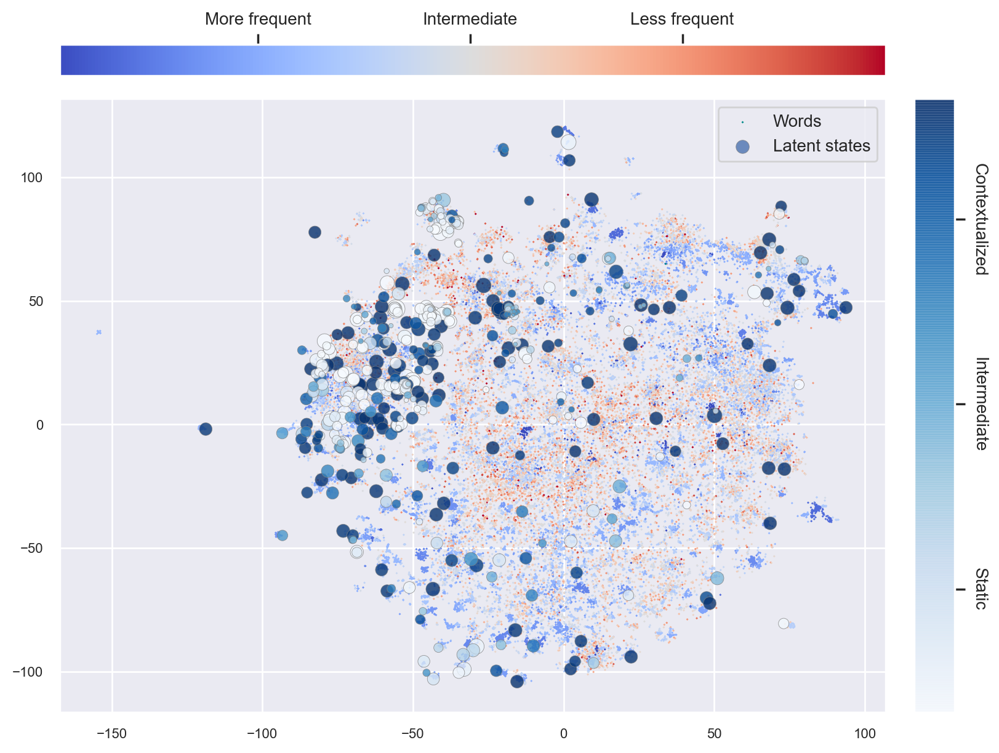

In [86]:
state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_word(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_freq_norm=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=False
                        )

## All States with query from original space

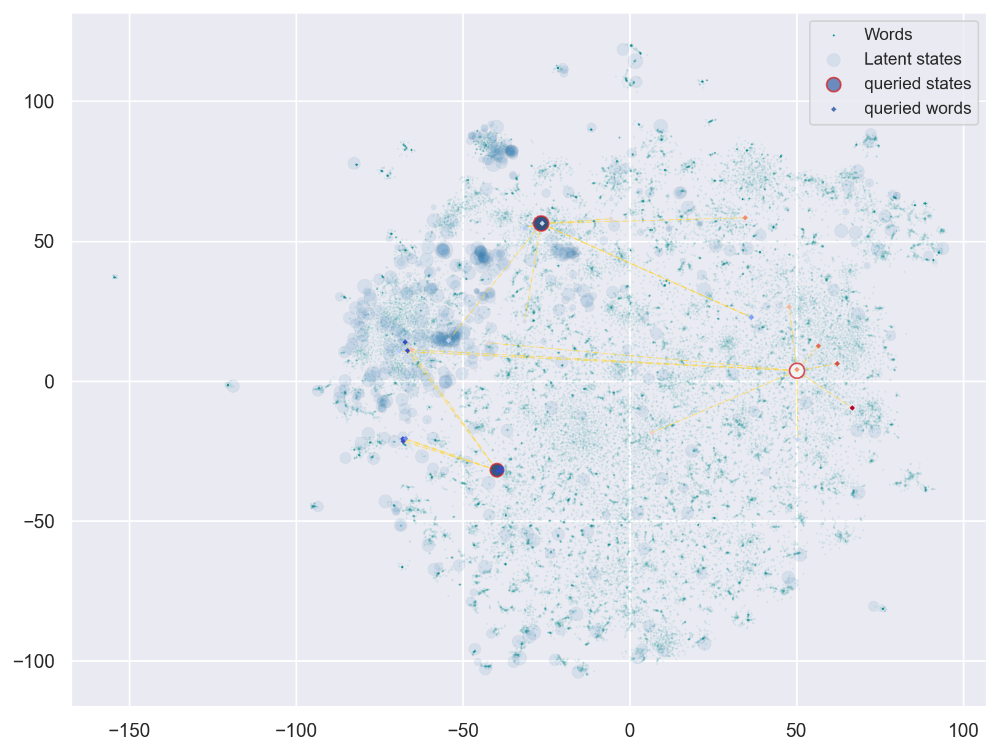

In [124]:
state_word_list = build_state_word_list([1236, 304, 1279], 
                                        state_id_origin_to_topk, sim_word_state, id2word, wordid2sentid, word_id_origin_to_non_stop, word_id_non_stop_to_sampled, n_words=10)
plot_state_word_w_query(emb_background_perp_10, 
                        state_matrix_transform_perp_10, 
                        state_nonstop_freq_r_, 
                        state_freq_norm_, 
                        word_sample_freq=word_freq_norm_, 
                        word_only=False, 
                        state_size_base=0.5, 
                        filter_static=False, 
                        filter_contextualized=False,
                        state_word_list=state_word_list,
                        high_light_query=True
                       )

## All States with query within transformed  space

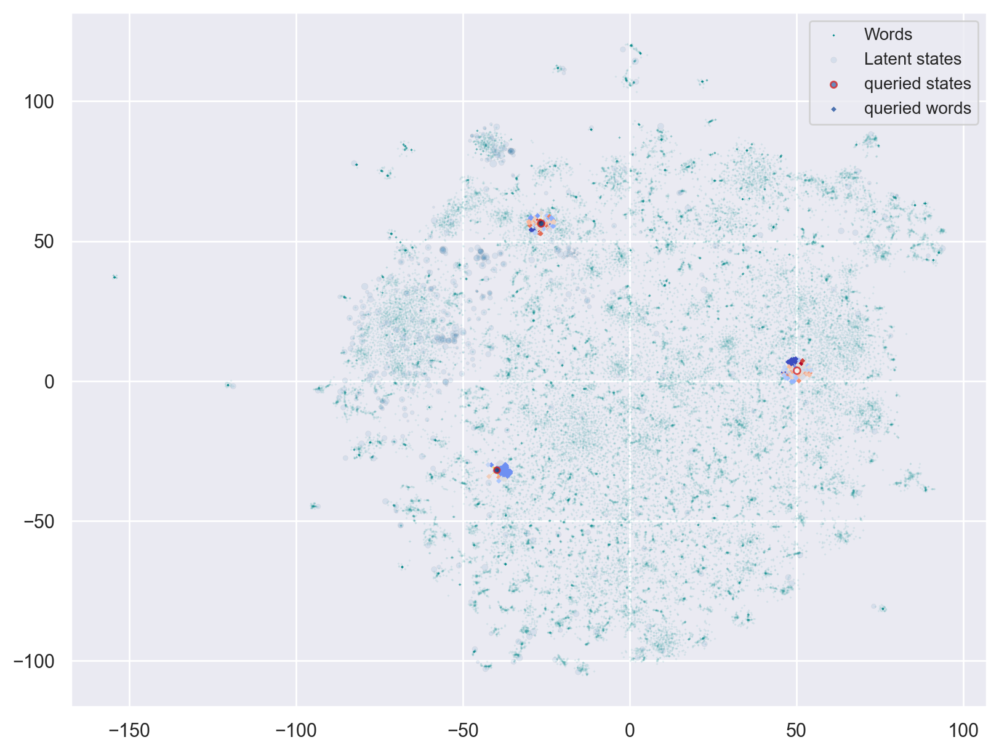

In [120]:
state_word_list = build_state_word_list_transformed([1236, 304, 1279],
                                  state_matrix_transform_perp_10, emb_background_perp_10, 
                                  state_id_origin_to_topk, word_id_sampled_to_non_stop, word_id_non_stop_to_origin, id2word, n_words=100)
plot_state_word_w_query(emb_background_perp_10, 
                        state_matrix_transform_perp_10, 
                        state_nonstop_freq_r_, 
                        state_freq_norm_, 
                        word_sample_freq=word_freq_norm_, 
                        word_only=False, 
                        state_size_base=0.1, 
                        filter_static=False, 
                        filter_contextualized=False,
                        state_word_list=state_word_list,
                        high_light_query=True
                       )

## Contextualized States

100%|██████████| 40000/40000 [00:00<00:00, 399906.94it/s]


56


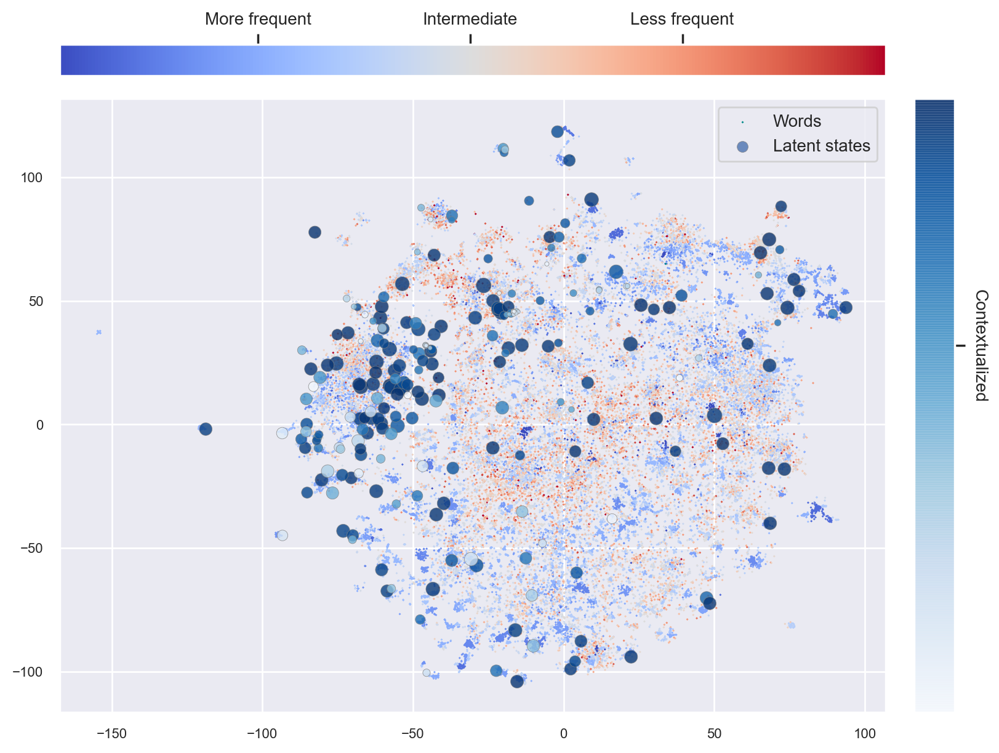

In [44]:
state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_word(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_freq_norm=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=True
                        )

## Static States

100%|██████████| 40000/40000 [00:00<00:00, 375534.21it/s]


56


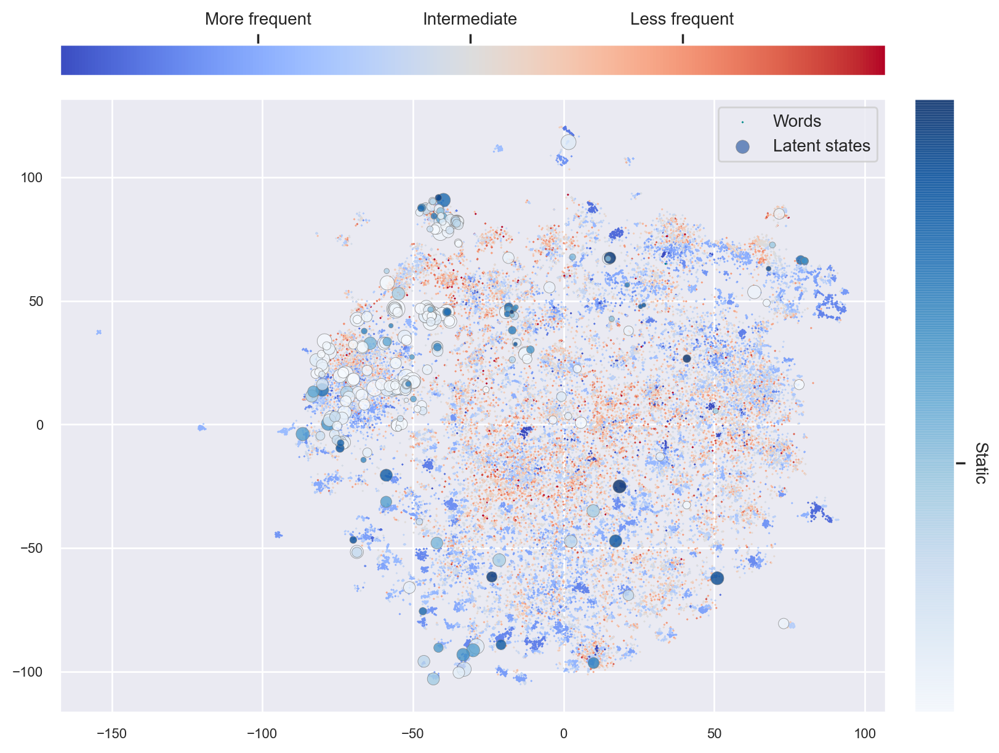

In [45]:
state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_word(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_freq_norm=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=True, 
                         filter_contextualized=False
                        )

# PPL = 50, top k = 500, sample size = 26000

## Do not color words

### All states

In [ ]:
topk=500
sample_size = emb_non_stop.size()[0]

embeddings_vis = tsne_preprocess(state_matrix, emb_non_stop, topk, sample_size)
emb_background_perp_50, state_matrix_transform_perp_50 = tsne_transform_dot_prod_no_state(embeddings_vis, 50, 1000, topk)

state_nonstop_freq_r_ = state_nonstop_freq_r[freq_idx_sort][: topk]
state_freq_norm_ = state_freq_norm[freq_idx_sort][: topk]

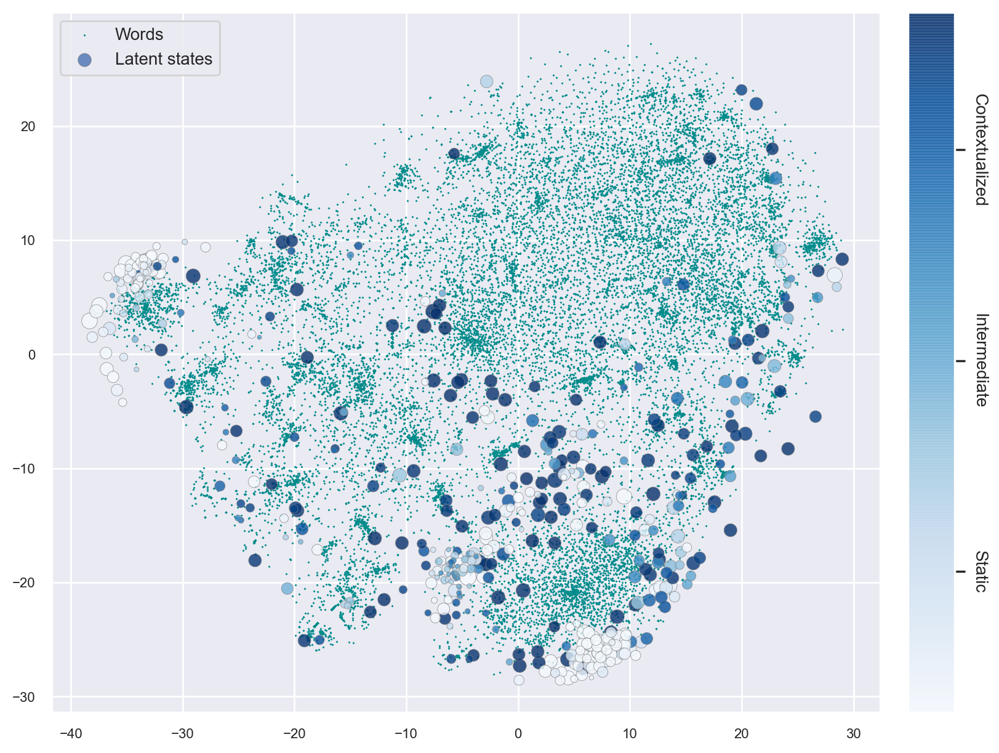

In [84]:
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=None, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=False
                        )

### Static states

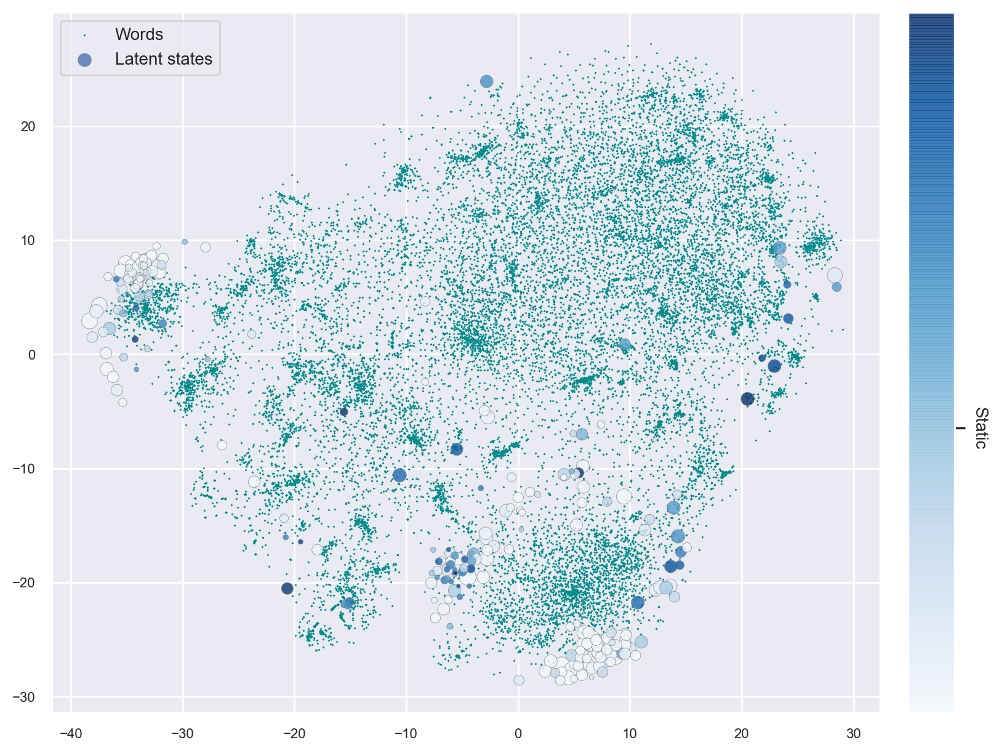

In [62]:
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=None, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=True, 
                         filter_contextualized=False
                        )

### Contextualized States

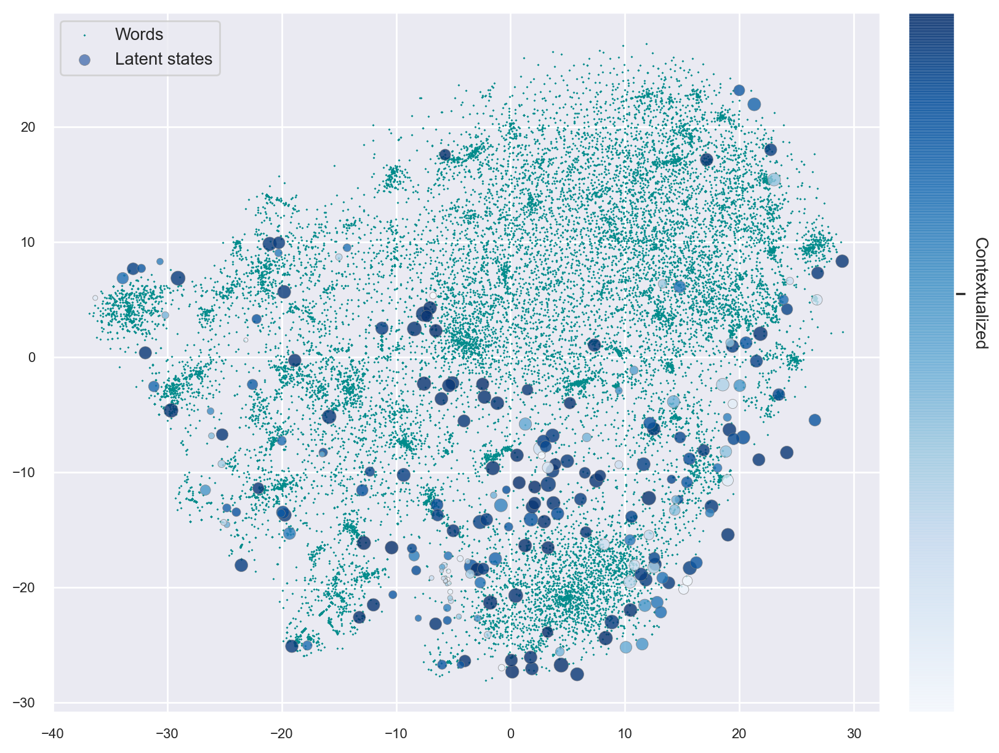

In [63]:
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=None, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=True
                        )

## Color words by word frequency

### word only

100%|██████████| 22377/22377 [00:00<00:00, 453211.10it/s]

30


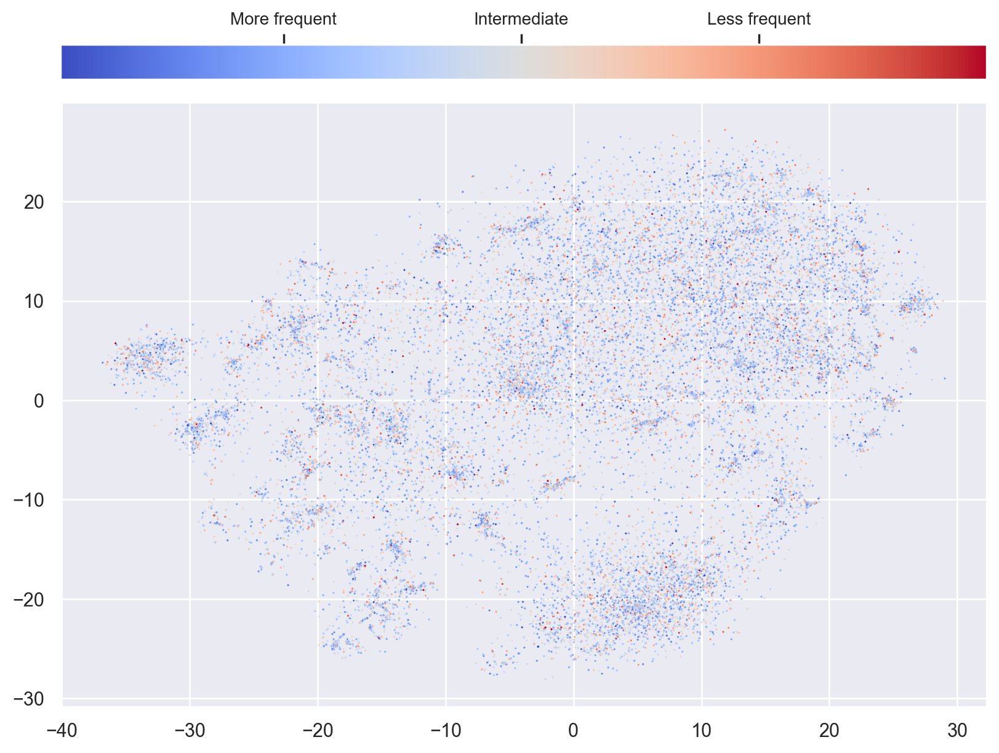

In [76]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=True, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=False
                        )

### words + all states

100%|██████████| 22377/22377 [00:00<00:00, 447314.33it/s]


30


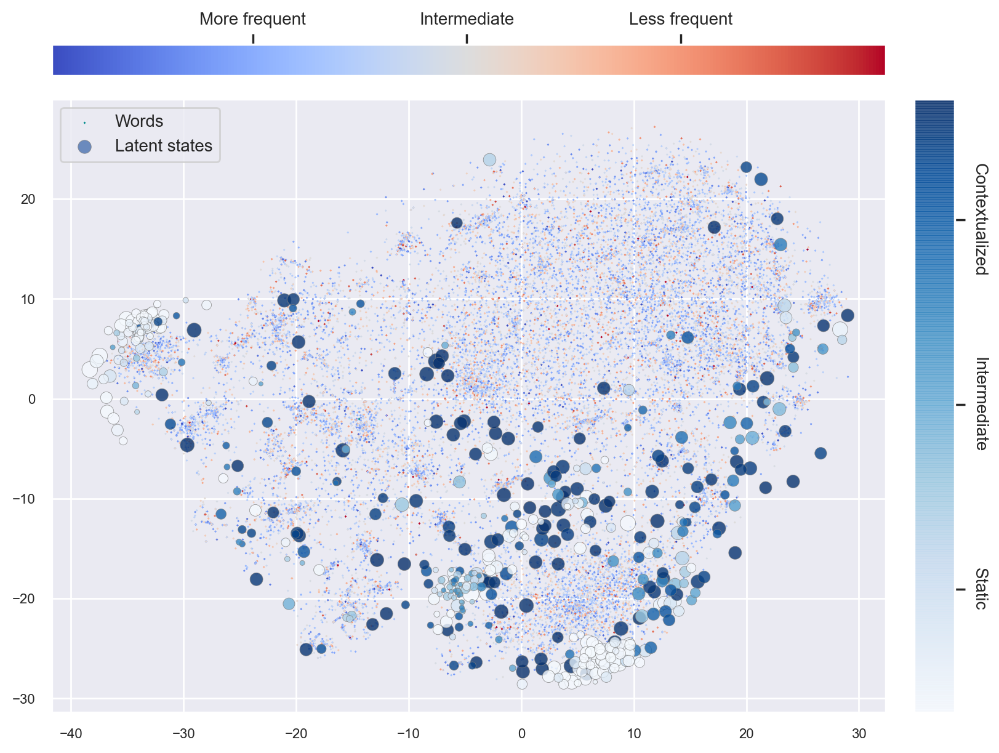

In [77]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=False
                        )

### words + static states

100%|██████████| 22377/22377 [00:00<00:00, 406661.90it/s]


30


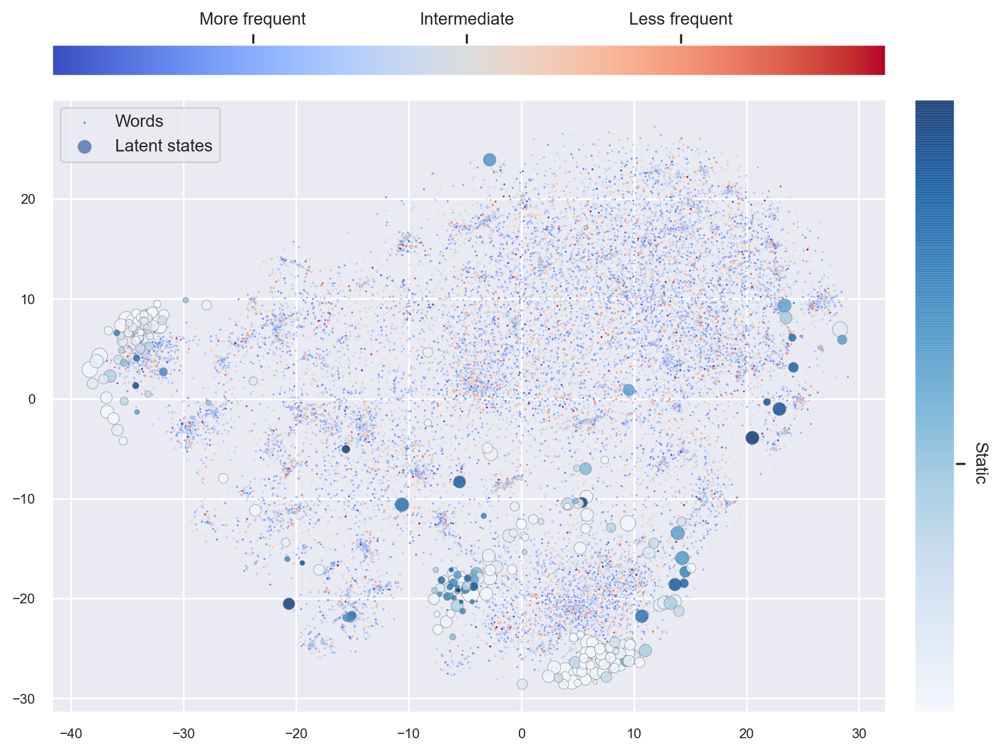

In [78]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=True, 
                         filter_contextualized=False
                        )

### words + contextualized states

100%|██████████| 22377/22377 [00:00<00:00, 456304.68it/s]


30


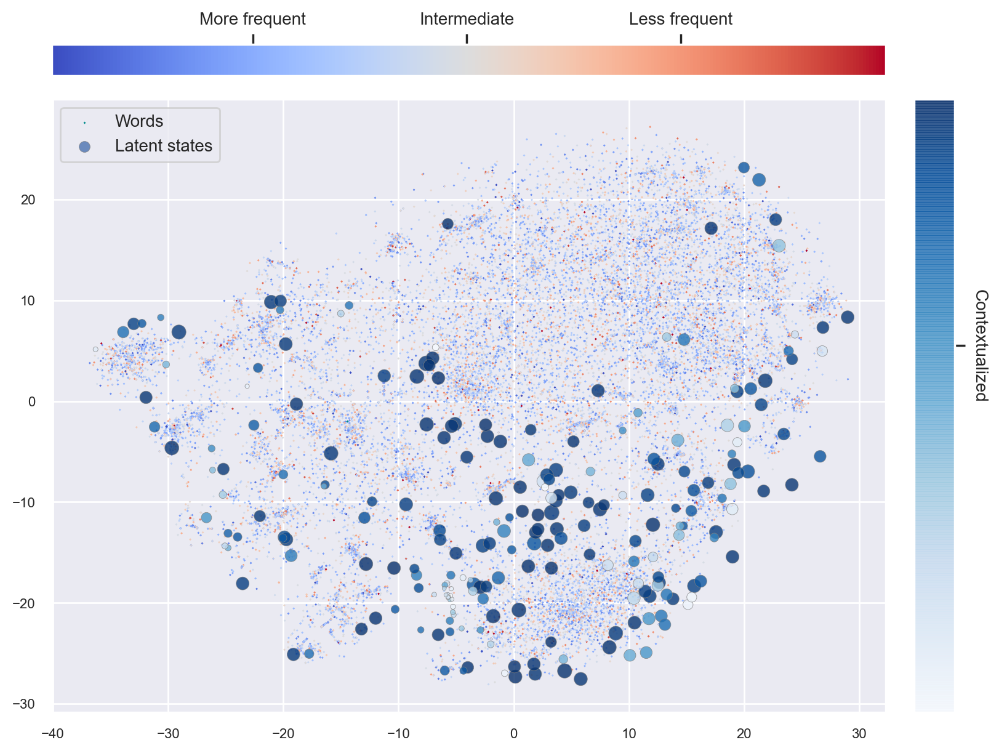

In [79]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=True
                        )

## Color words by number of states that a word correspond to 

### words only

100%|██████████| 22377/22377 [00:00<00:00, 407357.32it/s]

2157


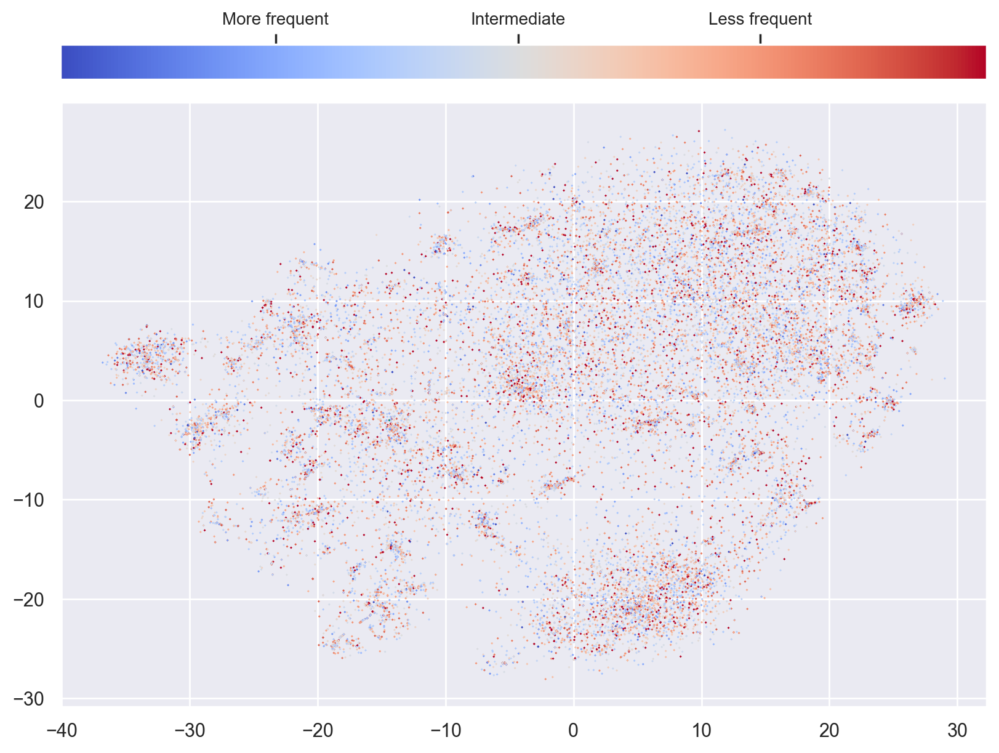

In [80]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_state_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=True, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=False
                        )

### words + all states

100%|██████████| 22377/22377 [00:00<00:00, 386225.72it/s]


2157


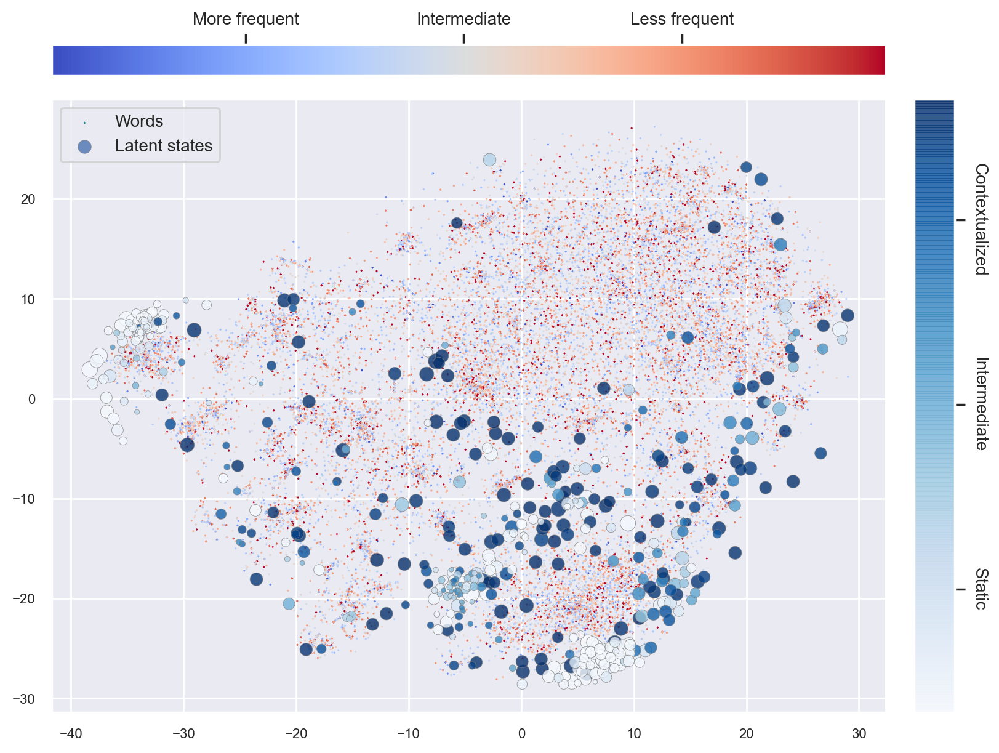

In [81]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_state_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=False
                        )

### words + static states

100%|██████████| 22377/22377 [00:00<00:00, 455306.35it/s]


2157


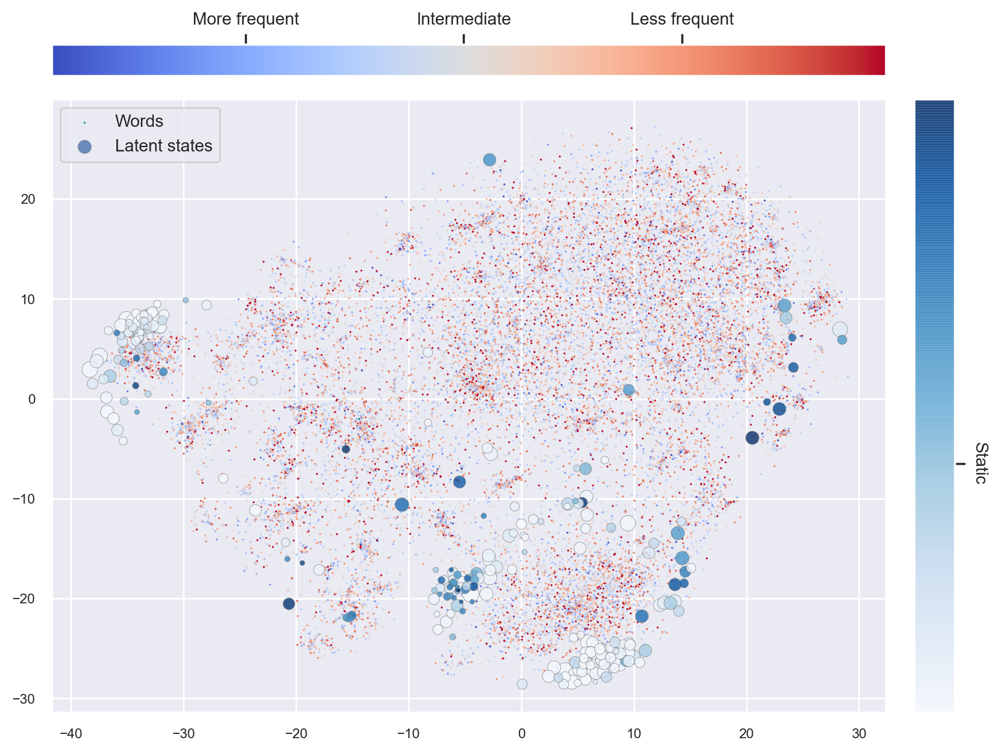

In [82]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_state_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=True, 
                         filter_contextualized=False
                        )

### words + contextualized states

100%|██████████| 22377/22377 [00:00<00:00, 406771.18it/s]


2157


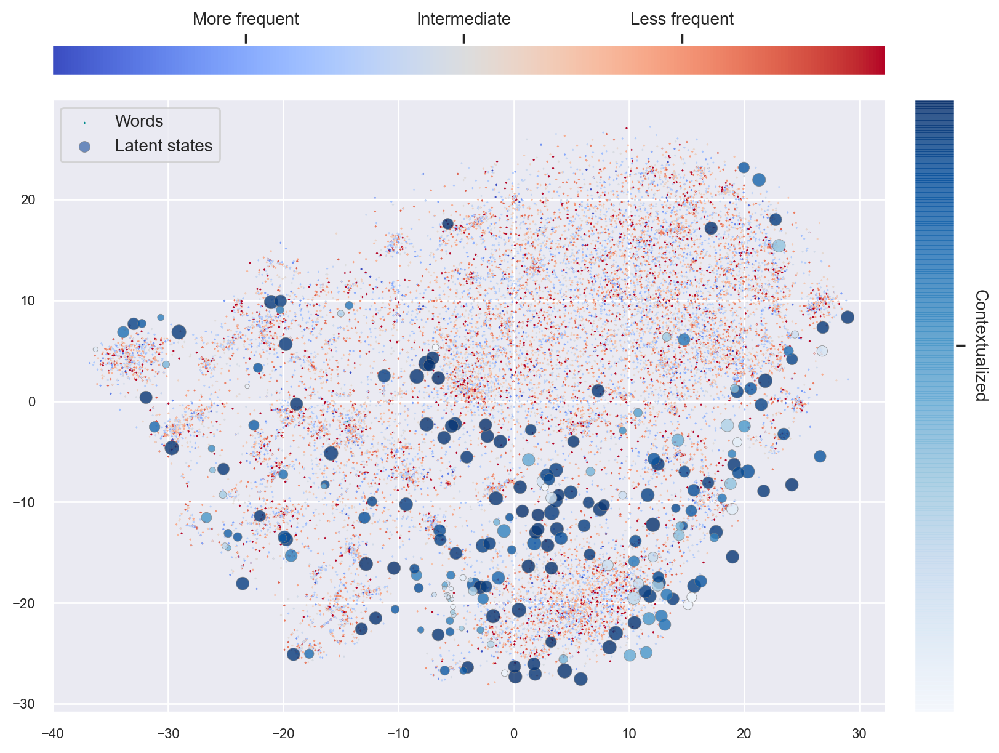

In [83]:
sample_idx = np.arange(len(emb_non_stop))
word_freq_norm_ = get_word_sample_freq(sample_idx, word_state_freq_norm, id2word, emb_non_stop_ids)
plot_state_non_stop_test(emb_background_perp_10,
                         state_matrix_transform_perp_10, 
                         state_nonstop_freq_r_, 
                         state_freq_norm_, 
                         word_sample_freq=word_freq_norm_, 
                         word_only=False, 
                         state_size_base=0.5, 
                         filter_static=False, 
                         filter_contextualized=True
                        )